<a href="https://colab.research.google.com/github/danielfurlan/aisite/blob/master/EDA_Tennis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Notebook STILL IN PROGRESS!!

In [3]:

!pip install facets-overview

# Before data cleasing: getting know your raw data!

In [4]:
# Load UCI census train and test data into dataframes.
import pandas as pd

df_atp = pd.read_csv(
    "/content/df_atp.csv", index_col=0)
df = pd.read_csv(
    "/content/data_4q .csv", index_col=0)

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (12,13,16,17,18,19,25,39) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [5]:
df.drop(df.columns[13:40],axis=1,inplace=True)
df.drop(["PSL",'UBW', 'UBL', 'LBW', 'LBL', 'SJW', 'SJL', 'MaxW', 'MaxL','AvgW', 'AvgL'],axis=1,inplace=True)
df.columns

Index(['ATP', 'Location', 'Tournament', 'Date', 'Series', 'Court', 'Surface',
       'Round', 'Best of', 'Winner', 'Loser', 'WRank', 'LRank', 'WPts', 'LPts',
       'Labels', 'Player1', 'Oponent', 'winner_past_vict', 'loser_past_vict'],
      dtype='object')

Lets take a good look at what our data is about using this super cool component called Facets (take a look at the docs : https://pair-code.github.io/facets/ )! You can explore your data in very different ways and we'll use it for 2 purposes:

1.   Get a first insight about our data before everything & prepare to do cleansing
2.   Get a second insight about our prepared data to feed our model



In [13]:
# Create the feature stats for the datasets and stringify it.
import base64
from facets_overview.generic_feature_statistics_generator import GenericFeatureStatisticsGenerator

gfsg = GenericFeatureStatisticsGenerator()
proto = gfsg.ProtoFromDataFrames([{'name': 'train', 'table': df_atp}])
protostr = base64.b64encode(proto.SerializeToString()).decode("utf-8")
# Display the facets overview visualization for this data
from IPython.core.display import display, HTML

HTML_TEMPLATE = """
        <script src="https://cdnjs.cloudflare.com/ajax/libs/webcomponentsjs/1.3.3/webcomponents-lite.js"></script>
        <link rel="import" href="https://raw.githubusercontent.com/PAIR-code/facets/1.0.0/facets-dist/facets-jupyter.html" >
        <facets-overview id="elem"></facets-overview>
        <script>
          document.querySelector("#elem").protoInput = "{protostr}";
        </script>"""
html = HTML_TEMPLATE.format(protostr=protostr)
display(HTML(html))


From the above charts we can already observe:

1.   errors (W5 & L5) should not have '70' as max values ( the max value a set can have is 7!)
2.   missing values in a lot of features (specially on the betting odds)!!
most of matches ended in a 3 sets mode (need to check the tournament, as Grand Slams can have 5!)

And how the surfaces are spread along the Series? Court? And by tournaments? Check the Facet Dives below for the answers



# After data cleasing: knowing with what you're feeding your machine learning model!

The prepared data used here can be viewed at Tennis Part 2: Modelization & Prediction: https://www.kaggle.com/danielfmfurlan/tennis

Getting the most correlated features

les 10 variables qui ont une plus forte correlation : 
 WPts              LPts                0.961394
WRank             winner_past_vict    0.530164
LRank             loser_past_vict     0.469988
winner_past_vict  loser_past_vict     0.250665
WRank             loser_past_vict     0.143347
LRank             winner_past_vict    0.126156
WRank             LRank               0.101546
WPts              winner_past_vict    0.096455
Best of           winner_past_vict    0.091164
                  WRank               0.066222
dtype: float64


<Figure size 2016x1440 with 0 Axes>

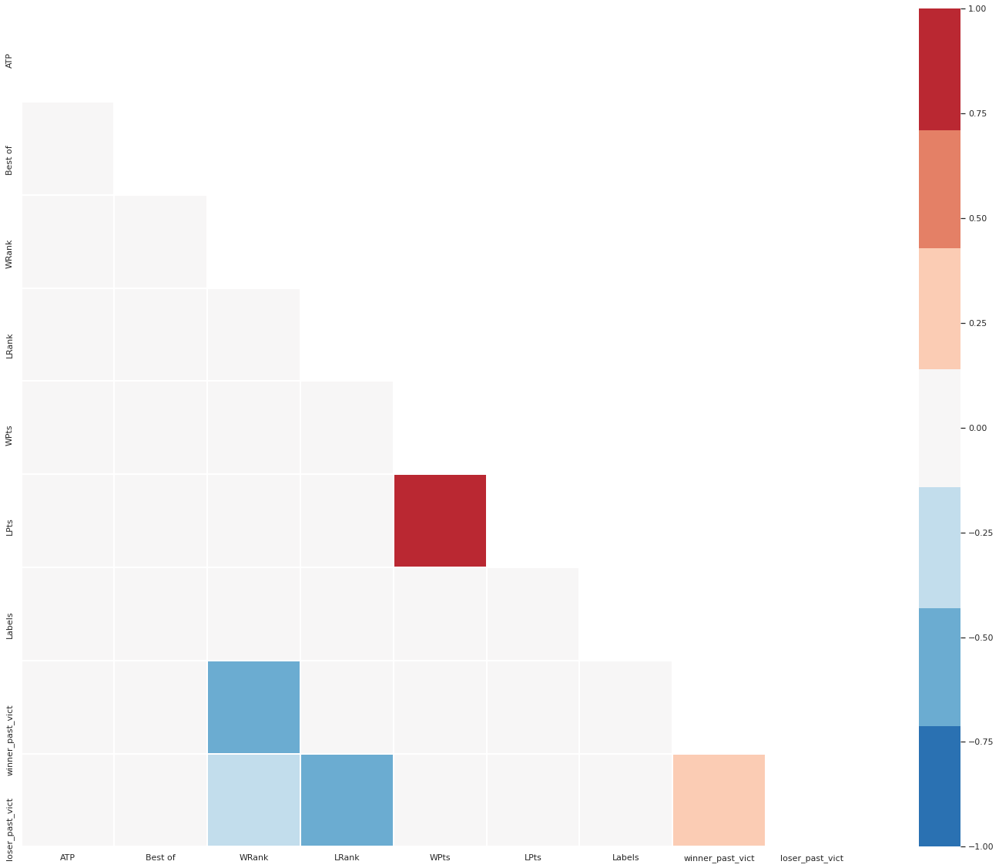

In [15]:
cor = df.corr()

import matplotlib.pyplot as plt     
import seaborn as sns; sns.set()
plt.figure(figsize=(28,20))

import numpy as np 
mask = np.zeros_like(cor)
mask[np.triu_indices_from(mask)] = True

with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(28, 20))
    ax = sns.heatmap(cor, center = 0, linewidth = 0.9, vmin = -1, vmax = 1, 
    cmap =  sns.color_palette("RdBu_r", 7),annot = False, mask=mask, square=True, fmt='.g')
    
corr_m = cor.abs()
sol = (corr_m.where(np.triu(np.ones(corr_m.shape), k=1).astype(np.bool))
                 .stack()
                 .sort_values(ascending=False))
print("les 10 variables qui ont une plus forte correlation : \n",sol[:10])

The Facest Dive is an interesting tool to visualize data in a friendly way:

In [14]:



# Display the Dive visualization for the training data.
from IPython.core.display import display, HTML

jsonstr = df.to_json(orient='records')
HTML_TEMPLATE = """
        <script src="https://cdnjs.cloudflare.com/ajax/libs/webcomponentsjs/1.3.3/webcomponents-lite.js"></script>
        <link rel="import" href="https://raw.githubusercontent.com/PAIR-code/facets/1.0.0/facets-dist/facets-jupyter.html">
        <facets-dive id="elem" height="600"></facets-dive>
        <script>
          var data = {jsonstr};
          document.querySelector("#elem").data = data;
        </script>"""
html = HTML_TEMPLATE.format(jsonstr=jsonstr)
display(HTML(html))

For instance, if you put "Court" at "Bimming X" tab, you gonna see that "outdoor" court is not present at "Grand Slam" tournament! You only have "indoor" matches at "Grand Slam"!

Now lets take a look at how the data is spread through train and test split!

In [12]:
# Create the feature stats for the datasets and stringify it.
valid_size = int(len(df) * 0.1)

train = df[:-valid_size * 2]
test = df[-valid_size:]

gfsg = GenericFeatureStatisticsGenerator()
proto = gfsg.ProtoFromDataFrames([{'name': 'train', 'table': train},
                                  {'name': 'test', 'table': test}])
protostr = base64.b64encode(proto.SerializeToString()).decode("utf-8")
# Display the facets overview visualization for this data
from IPython.core.display import display, HTML

HTML_TEMPLATE = """
        <script src="https://cdnjs.cloudflare.com/ajax/libs/webcomponentsjs/1.3.3/webcomponents-lite.js"></script>
        <link rel="import" href="https://raw.githubusercontent.com/PAIR-code/facets/1.0.0/facets-dist/facets-jupyter.html" >
        <facets-overview id="elem"></facets-overview>
        <script>
          document.querySelector("#elem").protoInput = "{protostr}";
        </script>"""
html = HTML_TEMPLATE.format(protostr=protostr)
display(HTML(html))

Wow!! Nice to notice that there are some data ONLY present on the TEST part!! (e.g. the player - "Winner" or "Loser")

A lot of other analyses to be done yet...
still in progres...